In [ ]:
# Download the files
url = "http://yann.lecun.com/exdb/mnist/"
filenames = ['train-images-idx3-ubyte.gz', 'train-labels-idx1-ubyte.gz',
             't10k-images-idx3-ubyte.gz', 't10k-labels-idx1-ubyte.gz']
data = []
for filename in filenames:
    print("Downloading", filename)
    request.urlretrieve(url + filename, filename)
    with gzip.open(filename, 'rb') as f:
        if 'labels' in filename:
            # Load the labels as a one-dimensional array of integers
            data.append(np.frombuffer(f.read(), np.uint8, offset=8))
        else:
            # Load the images as a two-dimensional array of pixels
            data.append(np.frombuffer(f.read(), np.uint8, offset=16).reshape(-1,28*28))

# Split into training and testing sets
X_train, y_train, X_test, y_test = data

# Normalize the pixel values
X_train = X_train.astype(np.float32) / 255.0
X_test = X_test.astype(np.float32) / 255.0

# Convert labels to integers
y_train = y_train.astype(np.int64)
y_test = y_test.astype(np.int64)

In [ ]:
class VAE(AutoEncoder):
    def __init__(self):
        super().__init__()
        # Add mu and log_var layers for reparameterization
        self.mu = nn.Linear(self.num_hidden, self.num_hidden)
        self.log_var = nn.Linear(self.num_hidden, self.num_hidden)

    def reparameterize(self, mu, log_var):
        # Compute the standard deviation from the log variance
        std = torch.exp(0.5 * log_var)
        # Generate random noise using the same shape as std
        eps = torch.randn_like(std)
        # Return the reparameterized sample
        return mu + eps * std

    def forward(self, x):
        # Pass the input through the encoder
        encoded = self.encoder(x)
        # Compute the mean and log variance vectors
        mu = self.mu(encoded)
        log_var = self.log_var(encoded)
        # Reparameterize the latent variable
        z = self.reparameterize(mu, log_var)
        # Pass the latent variable through the decoder
        decoded = self.decoder(z)
        # Return the encoded output, decoded output, mean, and log variance
        return encoded, decoded, mu, log_var

    def sample(self, num_samples):
        with torch.no_grad():
            # Generate random noise
            z = torch.randn(num_samples, self.num_hidden).to(device)
            # Pass the noise through the decoder to generate samples
            samples = self.decoder(z)
        # Return the generated samples
        return samples

# Define a loss function that combines binary cross-entropy and Kullback-Leibler divergence
def loss_function(recon_x, x, mu, logvar):
    # Compute the binary cross-entropy loss between the reconstructed output and the input data
    BCE = F.binary_cross_entropy(recon_x, x.view(-1, 784), reduction="sum")
    # Compute the Kullback-Leibler divergence between the learned latent variable distribution and a standard Gaussian distribution
    KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    # Combine the two losses by adding them together and return the result
    return BCE + KLD

In [ ]:
# Convert the training data to PyTorch tensors
X_train = torch.from_numpy(X_train)

# Create the autoencoder model and optimizer
model = AutoEncoder()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# Define the loss function
criterion = nn.MSELoss()

# Set the device to GPU if available, otherwise use CPU
model.to(device)

# Create a DataLoader to handle batching of the training data
train_loader = torch.utils.data.DataLoader(
    X_train, batch_size=batch_size, shuffle=True
)

In [ ]:
def train_vae(X_train, learning_rate=1e-3, num_epochs=10, batch_size=32):
    # Convert the training data to PyTorch tensors
    X_train = torch.from_numpy(X_train).to(device)

    # Create the autoencoder model and optimizer
    model = VAE()
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    # Define the loss function
    criterion = nn.MSELoss(reduction="sum")

    # Set the device to GPU if available, otherwise use CPU
    model.to(device)

    # Create a DataLoader to handle batching of the training data
    train_loader = torch.utils.data.DataLoader(
        X_train, batch_size=batch_size, shuffle=True
    )

    # Training loop
    for epoch in range(num_epochs):
        total_loss = 0.0
        for batch_idx, data in enumerate(train_loader):
            # Get a batch of training data and move it to the device
            data = data.to(device)

            # Forward pass
            encoded, decoded, mu, log_var = model(data)

            # Compute the loss and perform backpropagation
            KLD = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp())
            loss = criterion(decoded, data) + 3 * KLD
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Update the running loss
            total_loss += loss.item() * data.size(0)

        # Print the epoch loss
        epoch_loss = total_loss / len(train_loader.dataset)
        print(
            "Epoch {}/{}: loss={:.4f}".format(epoch + 1, num_epochs, epoch_loss)
        )

    # Return the trained model
    return model

Epoch 1/100: loss=5865.9113
Epoch 2/100: loss=5299.6157
Epoch 3/100: loss=5170.2537
Epoch 4/100: loss=5080.0018
Epoch 5/100: loss=5024.6751
Epoch 6/100: loss=4987.6582
Epoch 7/100: loss=4955.6388
Epoch 8/100: loss=4930.8375
Epoch 9/100: loss=4910.4766
Epoch 10/100: loss=4889.2645
Epoch 11/100: loss=4870.8953
Epoch 12/100: loss=4864.2753
Epoch 13/100: loss=4849.3865
Epoch 14/100: loss=4837.7074
Epoch 15/100: loss=4823.8748
Epoch 16/100: loss=4818.5013
Epoch 17/100: loss=4806.4927
Epoch 18/100: loss=4801.6953
Epoch 19/100: loss=4793.1560
Epoch 20/100: loss=4785.3052
Epoch 21/100: loss=4783.9415
Epoch 22/100: loss=4778.7267
Epoch 23/100: loss=4768.4981
Epoch 24/100: loss=4770.6257
Epoch 25/100: loss=4761.8710
Epoch 26/100: loss=4759.7488
Epoch 27/100: loss=4750.8130
Epoch 28/100: loss=4746.2159
Epoch 29/100: loss=4746.5140
Epoch 30/100: loss=4738.0905
Epoch 31/100: loss=4734.9018
Epoch 32/100: loss=4733.2847
Epoch 33/100: loss=4729.3473
Epoch 34/100: loss=4727.6931
Epoch 35/100: loss=4725

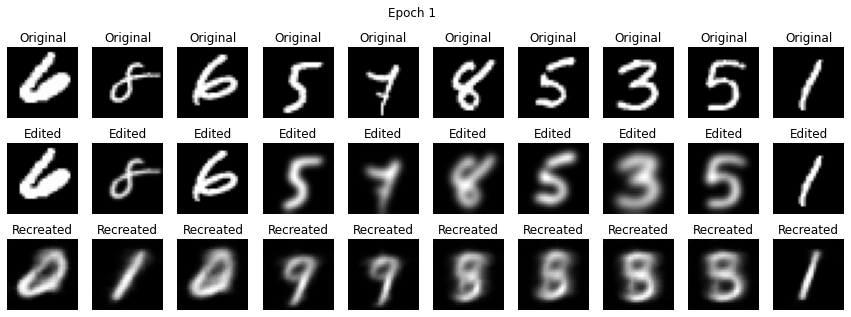

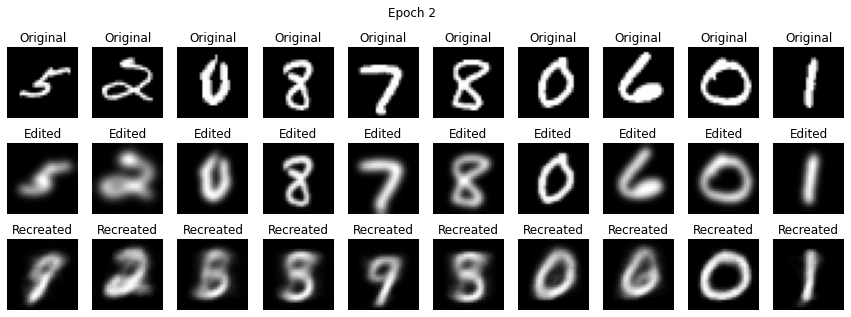

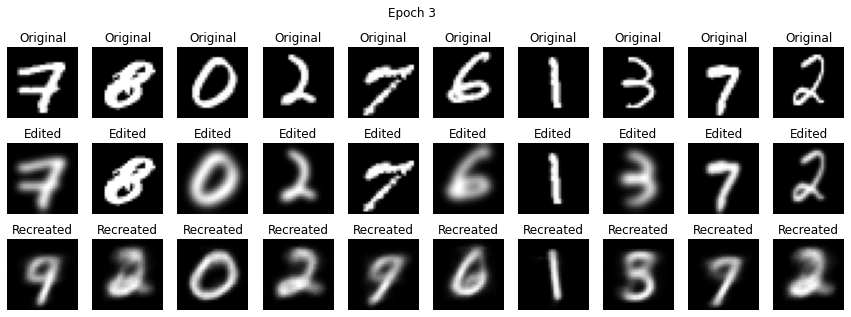

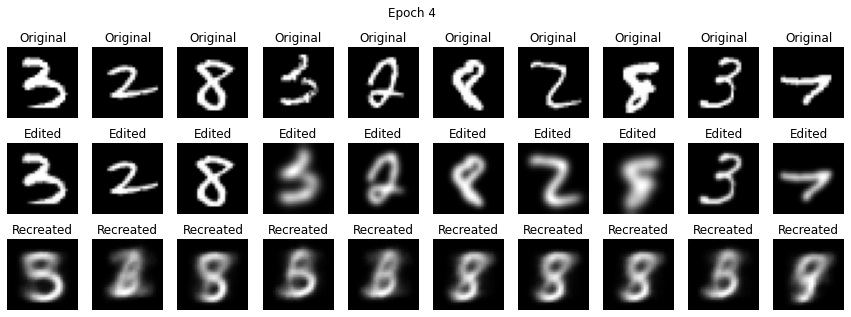

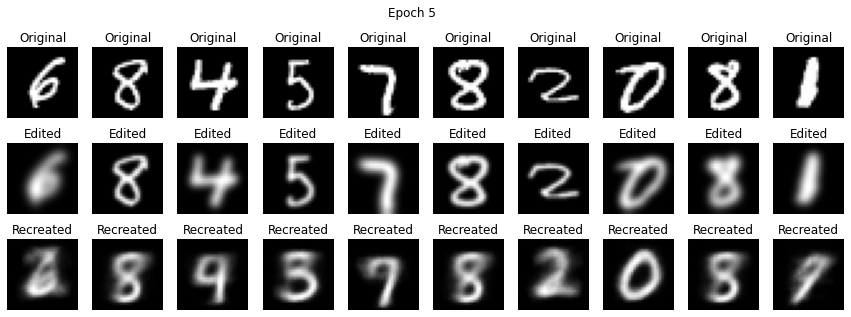

...

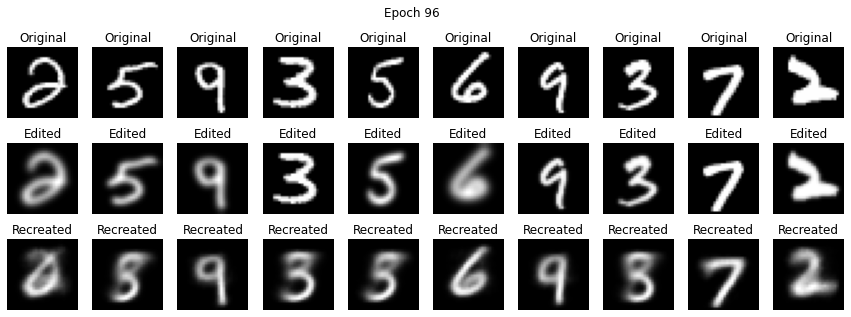

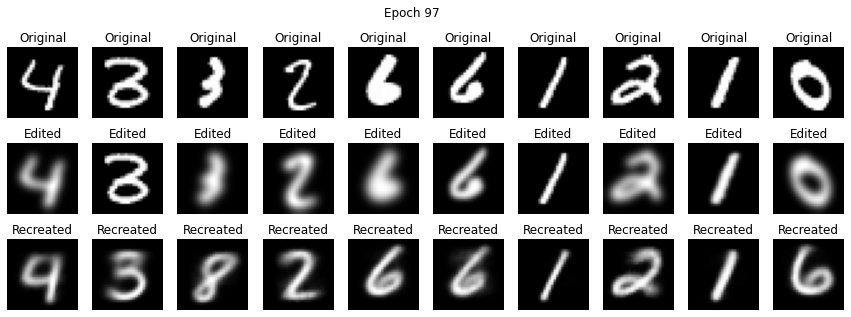

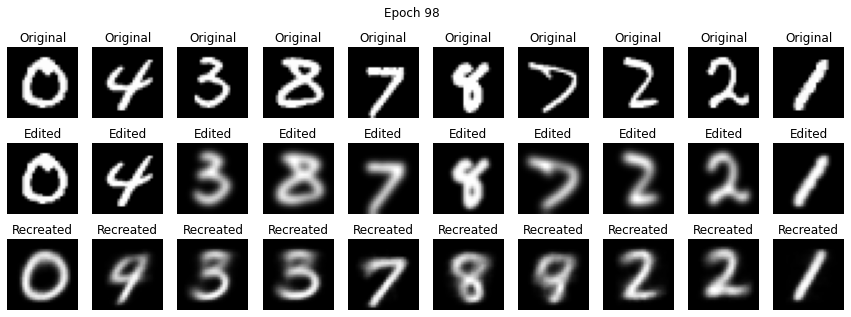

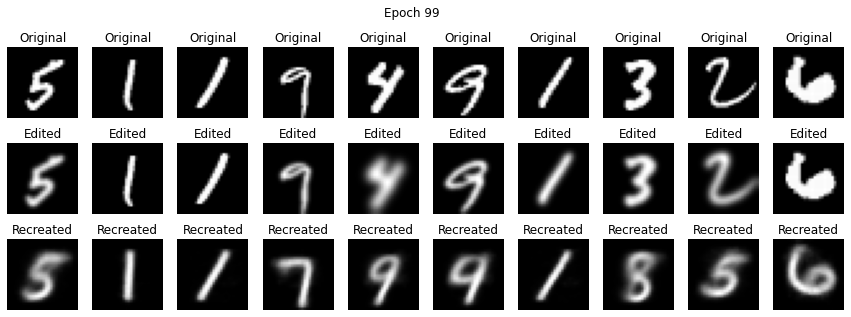

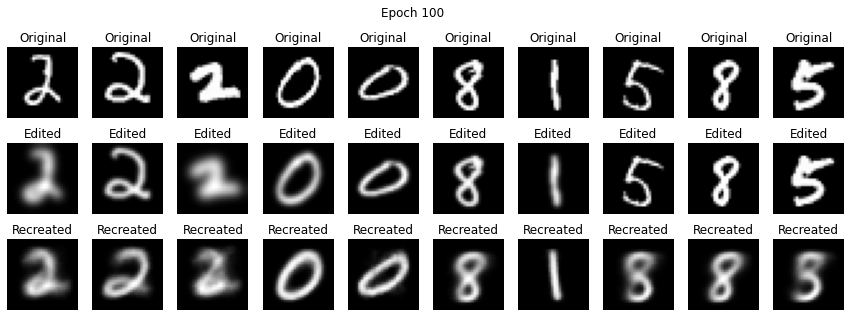

In [5]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets,transforms
import matplotlib.pyplot as plt

batch_size = 64
num_epochs = 100
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.GaussianBlur(kernel_size = (27,27))
    ])


#Create Dataset
input_data = datasets.MNIST(root = './data', train=True, download = True, transform=transform)
valid_data = datasets.MNIST(root = './data', train=True, download = True, transform=transforms.ToTensor())


def randomize():
    #Generate Random Sequence
    rand_indx = torch.randperm(len(input_data))

    #Randomize Data
    in_shuffle_data = torch.utils.data.Subset(input_data,rand_indx)
    valid_shuffle_data = torch.utils.data.Subset(valid_data,rand_indx)

    #Create Dataloader
    input_loader = torch.utils.data.DataLoader(dataset=in_shuffle_data, batch_size = batch_size, shuffle = False)
    valid_loader = torch.utils.data.DataLoader(dataset=valid_shuffle_data, batch_size = 64, shuffle = False)

    return input_loader, valid_loader

class Reshape(nn.Module):
    def __init__(self, *args):
        super().__init__()
        self.shape = args

    def forward(self,x):
        return x.view(self.shape)


class Trim(nn.Module):
    def __init__(self, *args):
        super().__init__()

    def forward(self, x):
        return x[:,:,:28,:28]


class VAE(nn.Module):
    def __init__(self):
        super().__init__()

        self.encoder = nn.Sequential(
                nn.Conv2d(1,32, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(32,64, stride=(2,2), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(64,64, stride=(2,2), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(64,64, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.Flatten(),
        )


        self.z_mean = torch.nn.Linear(3136,2)
        self.z_log_var = torch.nn.Linear(3136,2)

        self.decoder = nn.Sequential(
                torch.nn.Linear(2, 3136),
                Reshape(-1, 64, 7, 7),
                nn.ConvTranspose2d(64, 64, stride=(1, 1), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(64, 64, stride=(2, 2), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(64, 32, stride=(2, 2), kernel_size=(3, 3), padding=0),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(32, 1, stride=(1, 1), kernel_size=(3, 3), padding=0),
                Trim(),  # 1x29x29 -> 1x28x28
                nn.Sigmoid()
                )

    def encoding_fn(self,x):
        x = self.encoder(x)
        z_mean = self.z_mean(x)
        z_log_var = self.z_log_var(x)
        encoded = self.reparameterize(z_mean,z_log_var)
        return encoded, z_mean, z_log_var

    def reparameterize(self,z_mu, z_log_var):
        eps = torch.randn(z_mu.size(0), z_mu.size(1)).to(z_mu.get_device())
        z = z_mu+eps*torch.exp(z_log_var/2.)
        return z

    def forward(self,x):
        out = self.encoder(x)
        encoded, z_mean, z_log_var = self.encoding_fn(x)
        '''
        z_mean,z_log_var = self.z_mean(x), self.z_log_var(x)
        encoded = self.reparameterize(z_mean, z_log_var)
        '''
        decoded = self.decoder(encoded)
        return encoded, z_mean, z_log_var, decoded

def loss_function(x, decoded, z_mean, x_log_var):
    reproduction_loss = nn.MSELoss(decoded,x, reduction = 'sum')
    KLD = -0.5*torch.sum(1+x_log_var-mean.pow(2)-x_log_var.exp())

    return reproduction_loss + KLD, reproduction_loss, KLD

model = VAE()
model.to(device)
criterion = nn.MSELoss(reduction = "sum")
optimizer = torch.optim.Adam(model.parameters(), lr = 1e-3, weight_decay = 1e-5)

outputs = []


for epoch in range(num_epochs):
    total_loss = 0
    input_loader, valid_loader = randomize()
    iter_valid = iter(valid_loader)
    for batch in input_loader:
        images,_ = batch
        images = images.to(device)
        validation,_ = next(iter_valid)
        validation = validation.to(device)
        encoded,mean,logvar,decoded = model(images)
        KLD = -0.5 * torch.sum(1 + logvar - mean.pow(2) - logvar.exp())
        loss= criterion(decoded, validation)+KLD
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()*len(batch)
        
    #print(f'Loss: {loss} \n RPL: {rpl} \n KLD: {kld}')
    epoch_loss = total_loss/len(input_loader)
    #print(f'Epoch: {epoch+1}, Loss: {epoch_loss}:.4f}')
    
    print(
            "Epoch {}/{}: loss={:.4f}".format(epoch + 1, num_epochs, epoch_loss)
        )
    outputs.append((epoch, validation.cpu(), images.cpu(), decoded.cpu().detach()))


def display_images(epoch, valid, edited, recon):
    fig, axes = plt.subplots(3, 10, figsize=(15, 5))
    for i in range(10):
        axes[0, i].imshow(valid[i].squeeze(), cmap='gray')
        axes[0, i].axis('off')
        axes[0, i].set_title('Original')
        axes[1, i].imshow(edited[i].squeeze(), cmap='gray')
        axes[1, i].axis('off')
        axes[1, i].set_title('Edited')
        axes[2, i].imshow(recon[i].squeeze(), cmap='gray')
        axes[2, i].axis('off')
        axes[2, i].set_title('Recreated')
    plt.suptitle(f'Epoch {epoch+1}')
    plt.show()

for epoch, valid, edited, recon in outputs:
    display_images(epoch, valid, edited, recon)

Epoch 1/100: loss=22269.0006
Epoch 2/100: loss=19985.5345
Epoch 3/100: loss=19575.3018
Epoch 4/100: loss=19353.6691
Epoch 5/100: loss=19235.8485
Epoch 6/100: loss=19093.4830
Epoch 7/100: loss=19015.6076
Epoch 8/100: loss=18945.4852
Epoch 9/100: loss=18856.5518
Epoch 10/100: loss=18799.0890
Epoch 11/100: loss=18756.8252
Epoch 12/100: loss=18712.0851
Epoch 13/100: loss=18671.5100
Epoch 14/100: loss=18729.8134
Epoch 15/100: loss=18588.3030
Epoch 16/100: loss=18579.4752
Epoch 17/100: loss=18538.2553
Epoch 18/100: loss=18502.1589
Epoch 19/100: loss=18475.1730
Epoch 20/100: loss=18461.7909
Epoch 21/100: loss=18431.5604
Epoch 22/100: loss=18407.3271
Epoch 23/100: loss=18407.5265
Epoch 24/100: loss=18365.8850
Epoch 25/100: loss=18346.5366
Epoch 26/100: loss=18458.3637
Epoch 27/100: loss=18348.3986
Epoch 28/100: loss=18305.6985
Epoch 29/100: loss=18280.7916
Epoch 30/100: loss=18280.8412
Epoch 31/100: loss=18253.0879
Epoch 32/100: loss=18249.3407
Epoch 33/100: loss=18236.2748
Epoch 34/100: loss=

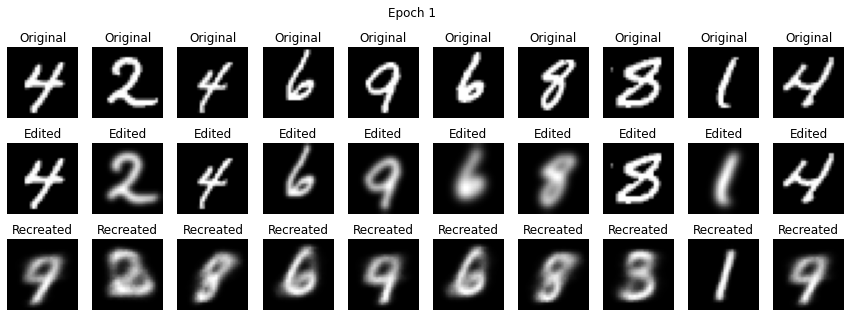

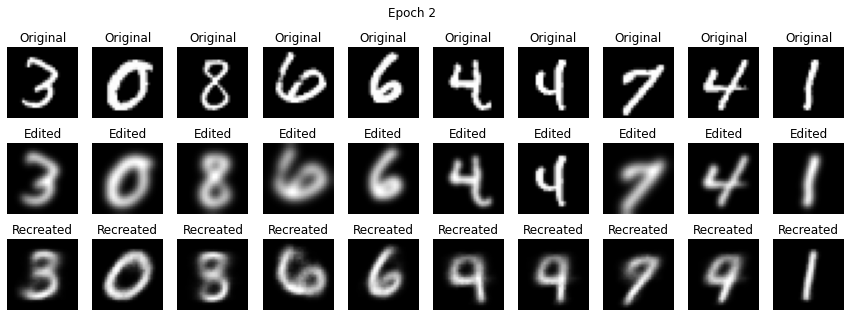

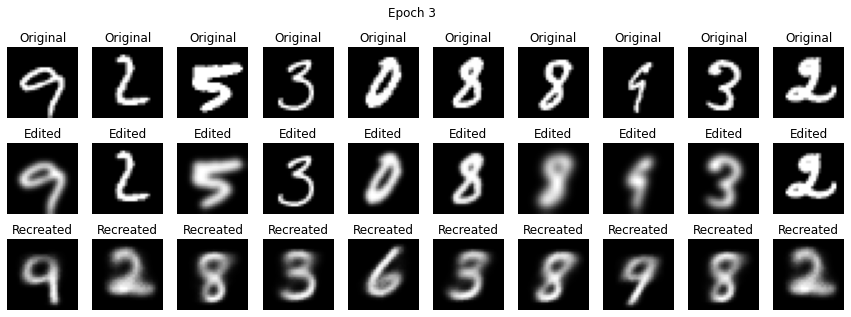

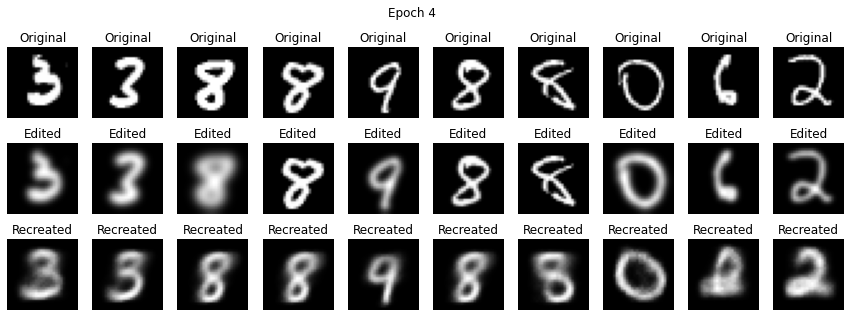

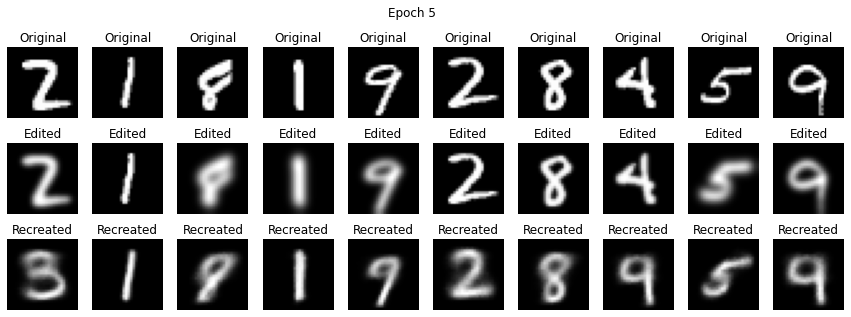

...

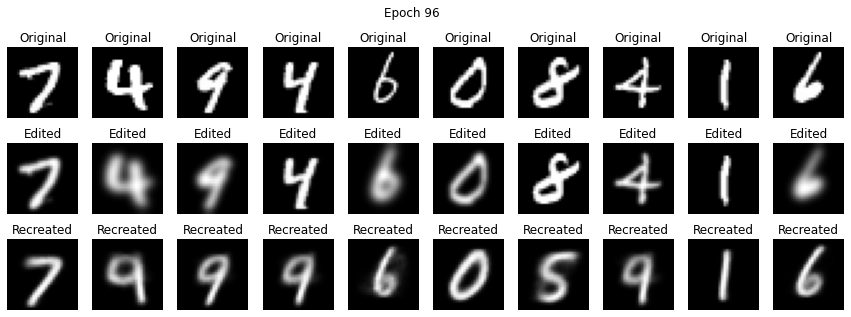

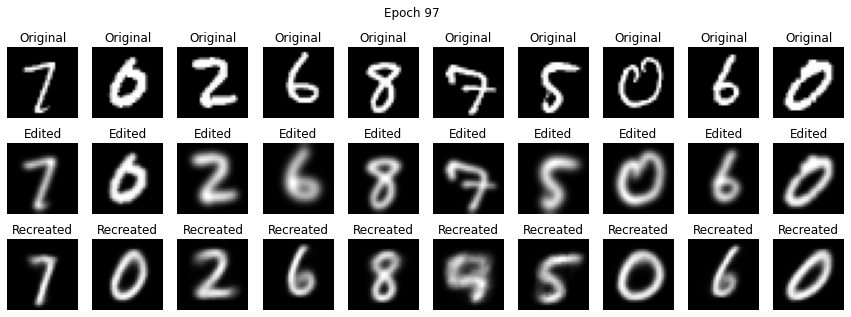

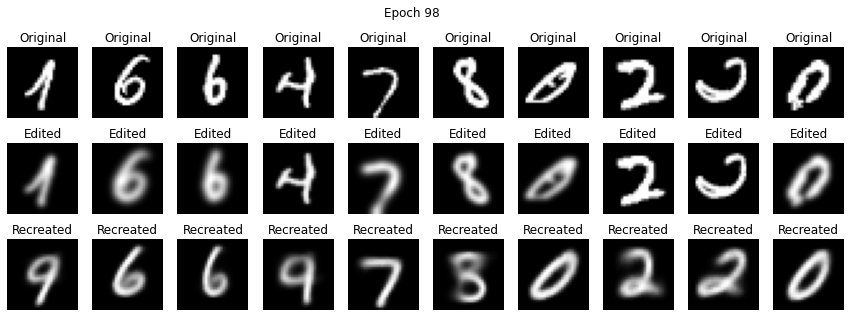

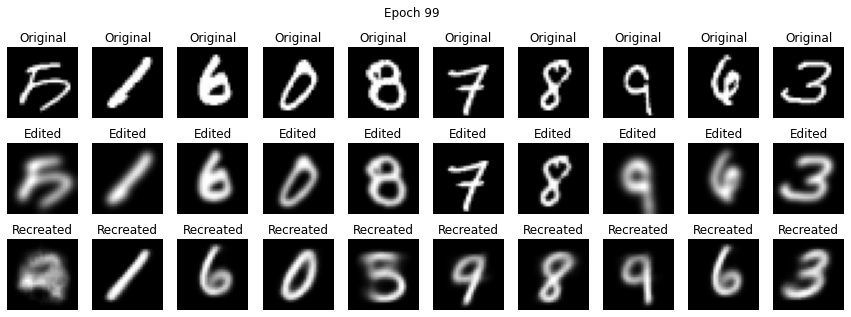

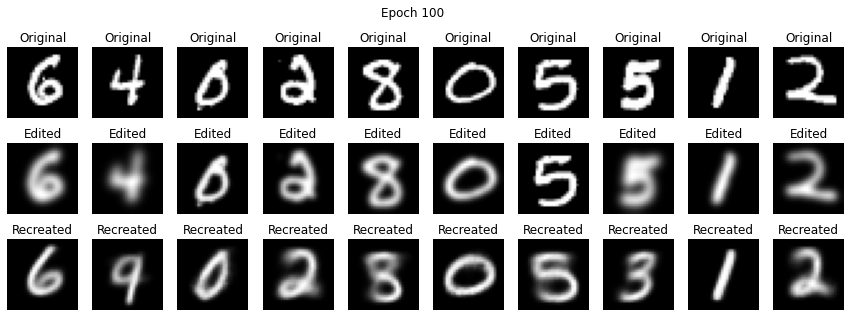

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets,transforms
import matplotlib.pyplot as plt

batch_size = 64
num_epochs = 100
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.GaussianBlur(kernel_size = (27,27))
    ])


#Create Dataset
input_data = datasets.MNIST(root = './data', train=True, download = True, transform=transform)
valid_data = datasets.MNIST(root = './data', train=True, download = True, transform=transforms.ToTensor())


def randomize():
    #Generate Random Sequence
    rand_indx = torch.randperm(len(input_data))

    #Randomize Data
    in_shuffle_data = torch.utils.data.Subset(input_data,rand_indx)
    valid_shuffle_data = torch.utils.data.Subset(valid_data,rand_indx)

    #Create Dataloader
    input_loader = torch.utils.data.DataLoader(dataset=in_shuffle_data, batch_size = batch_size, shuffle = False)
    valid_loader = torch.utils.data.DataLoader(dataset=valid_shuffle_data, batch_size = 64, shuffle = False)

    return input_loader, valid_loader

class Reshape(nn.Module):
    def __init__(self, *args):
        super().__init__()
        self.shape = args

    def forward(self,x):
        return x.view(self.shape)


class Trim(nn.Module):
    def __init__(self, *args):
        super().__init__()

    def forward(self, x):
        return x[:,:,:28,:28]


class VAE(nn.Module):
    def __init__(self):
        super().__init__()

        self.encoder = nn.Sequential(
                nn.Conv2d(1,32, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(32,64, stride=(2,2), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(64,128, stride=(2,2), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(128,256, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(256,256, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.Flatten()
                
        )


        self.z_mean = torch.nn.Linear(12544,2)
        self.z_log_var = torch.nn.Linear(12544,2)

        self.decoder = nn.Sequential(
                torch.nn.Linear(2, 12544),
                Reshape(-1, 256, 7, 7),
                nn.ConvTranspose2d(256, 256, stride=(1, 1), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(256, 128, stride=(1, 1), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(128, 64, stride=(2, 2), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(64, 32, stride=(2, 2), kernel_size=(3, 3), padding=0),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(32, 1, stride=(1, 1), kernel_size=(3, 3), padding=0),
                Trim(),  # 1x29x29 -> 1x28x28
                nn.Sigmoid()
                )

    def encoding_fn(self,x):
        x = self.encoder(x)
        z_mean = self.z_mean(x)
        z_log_var = self.z_log_var(x)
        encoded = self.reparameterize(z_mean,z_log_var)
        return encoded, z_mean, z_log_var

    def reparameterize(self,z_mu, z_log_var):
        eps = torch.randn(z_mu.size(0), z_mu.size(1)).to(z_mu.get_device())
        z = z_mu+eps*torch.exp(z_log_var/2.)
        return z

    def forward(self,x):
        out = self.encoder(x)
        encoded, z_mean, z_log_var = self.encoding_fn(x)
        '''
        z_mean,z_log_var = self.z_mean(x), self.z_log_var(x)
        encoded = self.reparameterize(z_mean, z_log_var)
        '''
        decoded = self.decoder(encoded)
        return encoded, z_mean, z_log_var, decoded

def loss_function(x, decoded, z_mean, x_log_var):
    reproduction_loss = torch.nn.functional.binary_cross_entropy(decoded,x, reduction = 'sum')
    KLD = -0.5*torch.sum(1+x_log_var-mean.pow(2)-x_log_var.exp())

    return reproduction_loss + KLD, reproduction_loss, KLD

model = VAE()
model.to(device)
criterion = nn.MSELoss(reduction = "sum")
optimizer = torch.optim.Adam(model.parameters(), lr = 1e-3, weight_decay = 1e-5)

outputs = []


for epoch in range(num_epochs):
    total_loss = 0
    input_loader, valid_loader = randomize()
    iter_valid = iter(valid_loader)
    for batch in input_loader:
        images,_ = batch
        images = images.to(device)
        validation,_ = next(iter_valid)
        validation = validation.to(device)
        encoded,mean,logvar,decoded = model(images)
        loss,rpl,kld = loss_function(validation,decoded,mean,logvar)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()*len(batch)
        
    #print(f'Loss: {loss} \n RPL: {rpl} \n KLD: {kld}')
    epoch_loss = total_loss/len(input_loader)
    #print(f'Epoch: {epoch+1}, Loss: {epoch_loss}:.4f}')
    
    print(
            "Epoch {}/{}: loss={:.4f}".format(epoch + 1, num_epochs, epoch_loss)
        )
    outputs.append((epoch, validation.cpu(), images.cpu(), decoded.cpu().detach()))


def display_images(epoch, valid, edited, recon):
    fig, axes = plt.subplots(3, 10, figsize=(15, 5))
    for i in range(10):
        axes[0, i].imshow(valid[i].squeeze(), cmap='gray')
        axes[0, i].axis('off')
        axes[0, i].set_title('Original')
        axes[1, i].imshow(edited[i].squeeze(), cmap='gray')
        axes[1, i].axis('off')
        axes[1, i].set_title('Edited')
        axes[2, i].imshow(recon[i].squeeze(), cmap='gray')
        axes[2, i].axis('off')
        axes[2, i].set_title('Recreated')
    plt.suptitle(f'Epoch {epoch+1}')
    plt.show()

for epoch, valid, edited, recon in outputs:
    display_images(epoch, valid, edited, recon)

Epoch 1/100: loss=17985.5147
Epoch 2/100: loss=13782.0326
Epoch 3/100: loss=13412.6465
Epoch 4/100: loss=13190.7527
Epoch 5/100: loss=13055.8982
Epoch 6/100: loss=12954.2481
Epoch 7/100: loss=12855.8440
Epoch 8/100: loss=12789.5846
Epoch 9/100: loss=12728.4150
Epoch 10/100: loss=12672.6259
Epoch 11/100: loss=12618.2823
Epoch 12/100: loss=12582.3109
Epoch 13/100: loss=12534.2459
Epoch 14/100: loss=12508.3590
Epoch 15/100: loss=12472.4392
Epoch 16/100: loss=12443.4108
Epoch 17/100: loss=12413.6874
Epoch 18/100: loss=12375.8473
Epoch 19/100: loss=12354.9271
Epoch 20/100: loss=12334.7005
Epoch 21/100: loss=12307.9110
Epoch 22/100: loss=12291.9913
Epoch 23/100: loss=12273.9346
Epoch 24/100: loss=12251.8736
Epoch 25/100: loss=12233.3873
Epoch 26/100: loss=12213.9136
Epoch 27/100: loss=12209.3008
Epoch 28/100: loss=12187.5952
Epoch 29/100: loss=12175.5452
Epoch 30/100: loss=12154.0240
Epoch 31/100: loss=12143.0468
Epoch 32/100: loss=12140.8720
Epoch 33/100: loss=12124.9788
Epoch 34/100: loss=

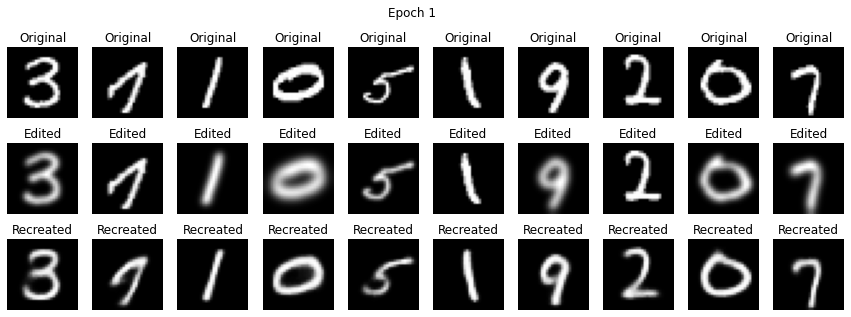

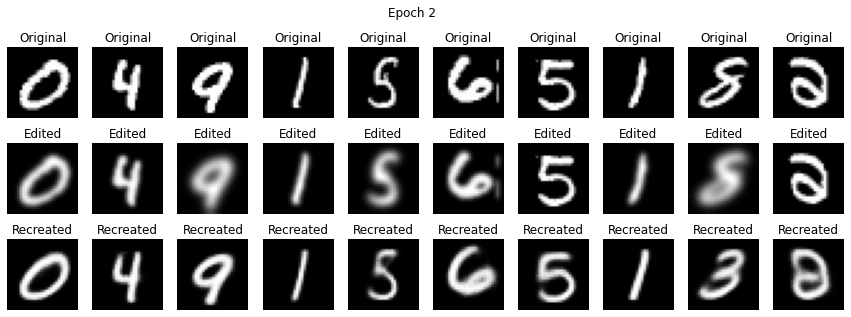

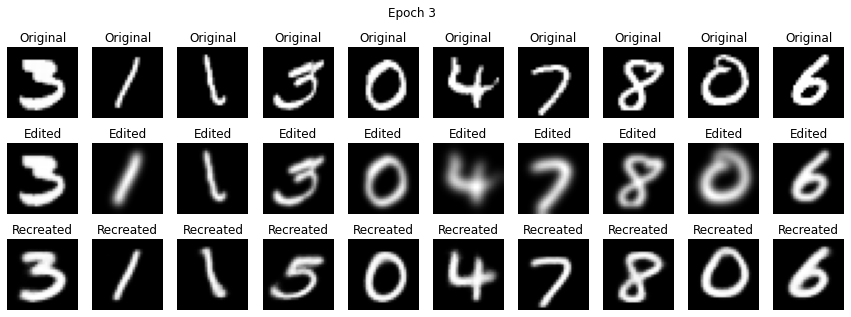

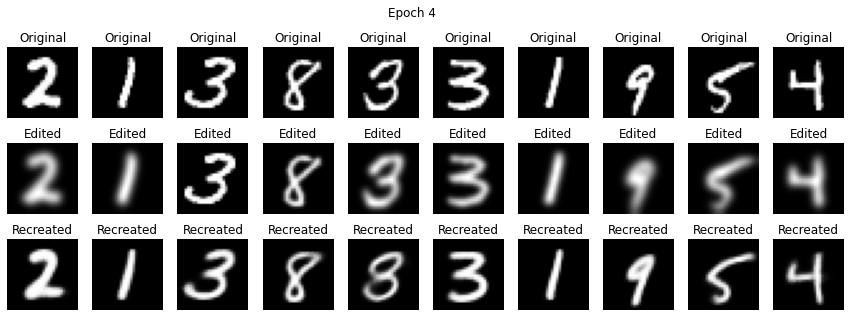

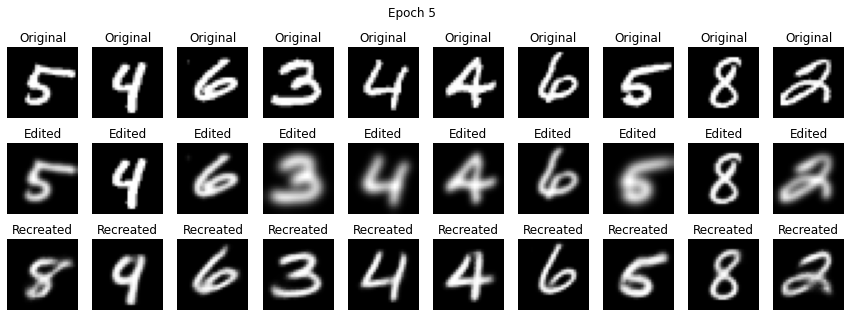

...

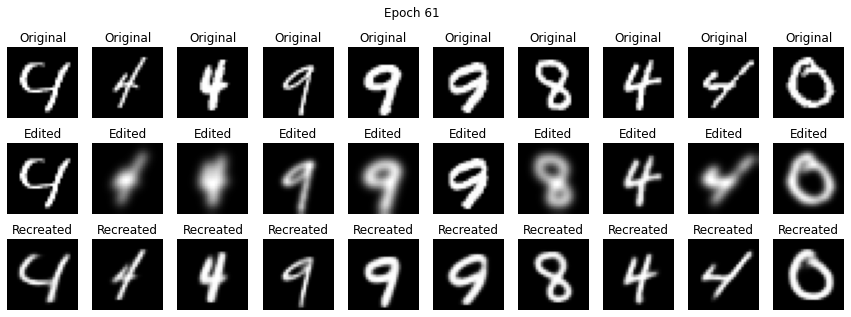

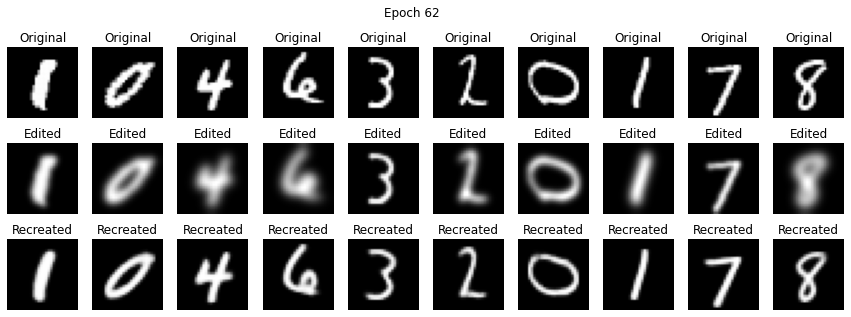

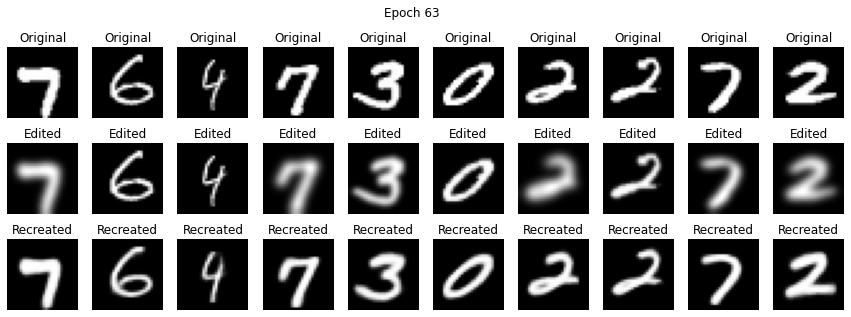

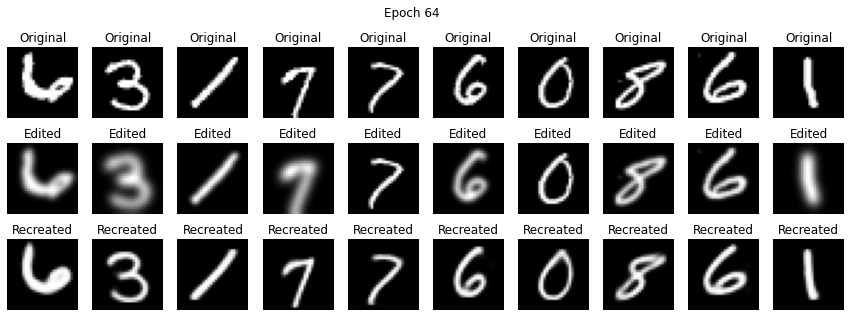

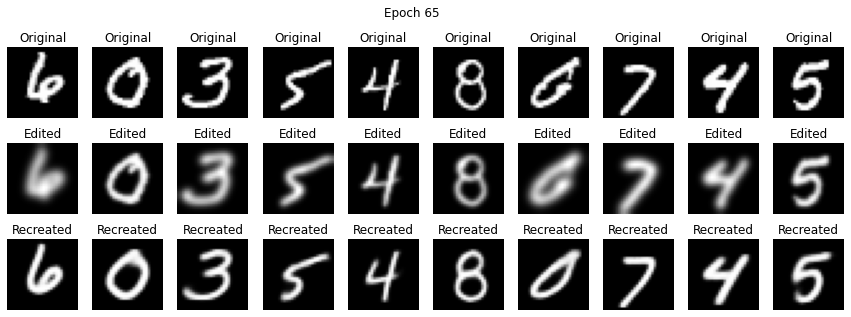

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets,transforms
import matplotlib.pyplot as plt

batch_size = 64
num_epochs = 100
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.GaussianBlur(kernel_size = (27,27))
    ])


#Create Dataset
input_data = datasets.MNIST(root = './data', train=True, download = True, transform=transform)
valid_data = datasets.MNIST(root = './data', train=True, download = True, transform=transforms.ToTensor())


def randomize():
    #Generate Random Sequence
    rand_indx = torch.randperm(len(input_data))

    #Randomize Data
    in_shuffle_data = torch.utils.data.Subset(input_data,rand_indx)
    valid_shuffle_data = torch.utils.data.Subset(valid_data,rand_indx)

    #Create Dataloader
    input_loader = torch.utils.data.DataLoader(dataset=in_shuffle_data, batch_size = batch_size, shuffle = False)
    valid_loader = torch.utils.data.DataLoader(dataset=valid_shuffle_data, batch_size = 64, shuffle = False)

    return input_loader, valid_loader

class Reshape(nn.Module):
    def __init__(self, *args):
        super().__init__()
        self.shape = args

    def forward(self,x):
        return x.view(self.shape)


class Trim(nn.Module):
    def __init__(self, *args):
        super().__init__()

    def forward(self, x):
        return x[:,:,:28,:28]


class VAE(nn.Module):
    def __init__(self):
        super().__init__()

        self.encoder = nn.Sequential(
                nn.Conv2d(1,32, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(32,64, stride=(2,2), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(64,128, stride=(2,2), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(128,256, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(256,256, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.Flatten()
                
        )


        self.z_mean = torch.nn.Linear(12544,10)
        self.z_log_var = torch.nn.Linear(12544,10)

        self.decoder = nn.Sequential(
                torch.nn.Linear(10, 12544),
                Reshape(-1, 256, 7, 7),
                nn.ConvTranspose2d(256, 256, stride=(1, 1), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(256, 128, stride=(1, 1), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(128, 64, stride=(2, 2), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(64, 32, stride=(2, 2), kernel_size=(3, 3), padding=0),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(32, 1, stride=(1, 1), kernel_size=(3, 3), padding=0),
                Trim(),  # 1x29x29 -> 1x28x28
                nn.Sigmoid()
                )

    def encoding_fn(self,x):
        x = self.encoder(x)
        z_mean = self.z_mean(x)
        z_log_var = self.z_log_var(x)
        encoded = self.reparameterize(z_mean,z_log_var)
        return encoded, z_mean, z_log_var

    def reparameterize(self,z_mu, z_log_var):
        eps = torch.randn(z_mu.size(0), z_mu.size(1)).to(z_mu.get_device())
        z = z_mu+eps*torch.exp(z_log_var/2.)
        return z

    def forward(self,x):
        out = self.encoder(x)
        encoded, z_mean, z_log_var = self.encoding_fn(x)
        '''
        z_mean,z_log_var = self.z_mean(x), self.z_log_var(x)
        encoded = self.reparameterize(z_mean, z_log_var)
        '''
        decoded = self.decoder(encoded)
        return encoded, z_mean, z_log_var, decoded

def loss_function(x, decoded, z_mean, x_log_var):
    reproduction_loss = torch.nn.functional.binary_cross_entropy(decoded,x, reduction = 'sum')
    KLD = -0.5*torch.sum(1+x_log_var-mean.pow(2)-x_log_var.exp())

    return reproduction_loss + KLD, reproduction_loss, KLD

model = VAE()
model.to(device)
criterion = nn.MSELoss(reduction = "sum")
optimizer = torch.optim.Adam(model.parameters(), lr = 1e-3, weight_decay = 1e-5)

outputs = []


for epoch in range(num_epochs):
    total_loss = 0
    input_loader, valid_loader = randomize()
    iter_valid = iter(valid_loader)
    for batch in input_loader:
        images,_ = batch
        images = images.to(device)
        validation,_ = next(iter_valid)
        validation = validation.to(device)
        encoded,mean,logvar,decoded = model(images)
        loss,rpl,kld = loss_function(validation,decoded,mean,logvar)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()*len(batch)
        
    #print(f'Loss: {loss} \n RPL: {rpl} \n KLD: {kld}')
    epoch_loss = total_loss/len(input_loader)
    #print(f'Epoch: {epoch+1}, Loss: {epoch_loss}:.4f}')
    
    print(
            "Epoch {}/{}: loss={:.4f}".format(epoch + 1, num_epochs, epoch_loss)
        )
    outputs.append((epoch, validation.cpu(), images.cpu(), decoded.cpu().detach()))


def display_images(epoch, valid, edited, recon):
    fig, axes = plt.subplots(3, 10, figsize=(15, 5))
    for i in range(10):
        axes[0, i].imshow(valid[i].squeeze(), cmap='gray')
        axes[0, i].axis('off')
        axes[0, i].set_title('Original')
        axes[1, i].imshow(edited[i].squeeze(), cmap='gray')
        axes[1, i].axis('off')
        axes[1, i].set_title('Edited')
        axes[2, i].imshow(recon[i].squeeze(), cmap='gray')
        axes[2, i].axis('off')
        axes[2, i].set_title('Recreated')
    plt.suptitle(f'Epoch {epoch+1}')
    plt.show()

for epoch, valid, edited, recon in outputs:
    display_images(epoch, valid, edited, recon)

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets,transforms
import matplotlib.pyplot as plt

batch_size = 64
num_epochs = 100
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.GaussianBlur(kernel_size = (27,27))
    ])


#Create Dataset
input_data = datasets.MNIST(root = './data', train=True, download = True, transform=transform)
valid_data = datasets.MNIST(root = './data', train=True, download = True, transform=transforms.ToTensor())


def randomize():
    #Generate Random Sequence
    rand_indx = torch.randperm(len(input_data))

    #Randomize Data
    in_shuffle_data = torch.utils.data.Subset(input_data,rand_indx)
    valid_shuffle_data = torch.utils.data.Subset(valid_data,rand_indx)

    #Create Dataloader
    input_loader = torch.utils.data.DataLoader(dataset=in_shuffle_data, batch_size = batch_size, shuffle = False)
    valid_loader = torch.utils.data.DataLoader(dataset=valid_shuffle_data, batch_size = 64, shuffle = False)

    return input_loader, valid_loader

class Reshape(nn.Module):
    def __init__(self, *args):
        super().__init__()
        self.shape = args

    def forward(self,x):
        return x.view(self.shape)


class Trim(nn.Module):
    def __init__(self, *args):
        super().__init__()

    def forward(self, x):
        return x[:,:,:28,:28]


class VAE(nn.Module):
    def __init__(self):
        super().__init__()

        self.encoder = nn.Sequential(
                nn.Conv2d(1,32, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(32,64, stride=(2,2), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(64,128, stride=(2,2), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(128,256, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(256,512, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(512,1024, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(1024,1024, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.Flatten()
                
        )


        self.z_mean = torch.nn.Linear(50176,10)
        self.z_log_var = torch.nn.Linear(50176,10)

        self.decoder = nn.Sequential(
                torch.nn.Linear(10, 50176),
                Reshape(-1, 1024, 7, 7),
                nn.ConvTranspose2d(1024, 1024, stride=(1, 1), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(1024, 512, stride=(1, 1), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(512, 256, stride=(1, 1), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(256, 128, stride=(1, 1), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(128, 64, stride=(2, 2), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(64, 32, stride=(2, 2), kernel_size=(3, 3), padding=0),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(32, 1, stride=(1, 1), kernel_size=(3, 3), padding=0),
                Trim(),  # 1x29x29 -> 1x28x28
                nn.Sigmoid()
                )

    def encoding_fn(self,x):
        x = self.encoder(x)
        z_mean = self.z_mean(x)
        z_log_var = self.z_log_var(x)
        encoded = self.reparameterize(z_mean,z_log_var)
        return encoded, z_mean, z_log_var

    def reparameterize(self,z_mu, z_log_var):
        eps = torch.randn(z_mu.size(0), z_mu.size(1)).to(z_mu.get_device())
        z = z_mu+eps*torch.exp(z_log_var/2.)
        return z

    def forward(self,x):
        out = self.encoder(x)
        encoded, z_mean, z_log_var = self.encoding_fn(x)
        '''
        z_mean,z_log_var = self.z_mean(x), self.z_log_var(x)
        encoded = self.reparameterize(z_mean, z_log_var)
        '''
        decoded = self.decoder(encoded)
        return encoded, z_mean, z_log_var, decoded

def loss_function(x, decoded, z_mean, x_log_var):
    reproduction_loss = torch.nn.functional.binary_cross_entropy(decoded,x, reduction = 'sum')
    KLD = -0.5*torch.sum(1+x_log_var-mean.pow(2)-x_log_var.exp())

    return reproduction_loss + KLD, reproduction_loss, KLD

model = VAE()
model.to(device)
criterion = nn.MSELoss(reduction = "sum")
optimizer = torch.optim.Adam(model.parameters(), lr = 1e-3, weight_decay = 1e-5)

outputs = []


for epoch in range(num_epochs):
    total_loss = 0
    input_loader, valid_loader = randomize()
    iter_valid = iter(valid_loader)
    for batch in input_loader:
        images,_ = batch
        images = images.to(device)
        validation,_ = next(iter_valid)
        validation = validation.to(device)
        encoded,mean,logvar,decoded = model(images)
        loss,rpl,kld = loss_function(validation,decoded,mean,logvar)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()*len(batch)
        
    #print(f'Loss: {loss} \n RPL: {rpl} \n KLD: {kld}')
    epoch_loss = total_loss/len(input_loader)
    #print(f'Epoch: {epoch+1}, Loss: {epoch_loss}:.4f}')
    
    print(
            "Epoch {}/{}: loss={:.4f}".format(epoch + 1, num_epochs, epoch_loss)
        )
    outputs.append((epoch, validation.cpu(), images.cpu(), decoded.cpu().detach()))


def display_images(epoch, valid, edited, recon):
    fig, axes = plt.subplots(3, 10, figsize=(15, 5))
    for i in range(10):
        axes[0, i].imshow(valid[i].squeeze(), cmap='gray')
        axes[0, i].axis('off')
        axes[0, i].set_title('Original')
        axes[1, i].imshow(edited[i].squeeze(), cmap='gray')
        axes[1, i].axis('off')
        axes[1, i].set_title('Edited')
        axes[2, i].imshow(recon[i].squeeze(), cmap='gray')
        axes[2, i].axis('off')
        axes[2, i].set_title('Recreated')
    plt.suptitle(f'Epoch {epoch+1}')
    plt.show()

for epoch, valid, edited, recon in outputs:
    display_images(epoch, valid, edited, recon)

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets,transforms
import matplotlib.pyplot as plt
import torch.nn.functional as F

batch_size = 64
num_epochs = 100
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.GaussianBlur(kernel_size = (27,27))
    ])


#Create Dataset
input_data = datasets.MNIST(root = './data', train=True, download = True, transform=transform)
valid_data = datasets.MNIST(root = './data', train=True, download = True, transform=transforms.ToTensor())


def randomize():
    #Generate Random Sequence
    rand_indx = torch.randperm(len(input_data))

    #Randomize Data
    in_shuffle_data = torch.utils.data.Subset(input_data,rand_indx)
    valid_shuffle_data = torch.utils.data.Subset(valid_data,rand_indx)

    #Create Dataloader
    input_loader = torch.utils.data.DataLoader(dataset=in_shuffle_data, batch_size = batch_size, shuffle = False)
    valid_loader = torch.utils.data.DataLoader(dataset=valid_shuffle_data, batch_size = 64, shuffle = False)

    return input_loader, valid_loader

class Reshape(nn.Module):
    def __init__(self, *args):
        super().__init__()
        self.shape = args

    def forward(self,x):
        return x.view(self.shape)


class Trim(nn.Module):
    def __init__(self, *args):
        super().__init__()

    def forward(self, x):
        return x[:,:,:28,:28]


class VAE(nn.Module):
    def __init__(self):
        super().__init__()
        
        self.num_hidden = 10
        self.num_classes = 10
        
        self.encoder = nn.Sequential(
                nn.Conv2d(1,32, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(32,64, stride=(2,2), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(64,128, stride=(2,2), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(128,256, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(256,512, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(512,1024, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.LeakyReLU(0.01),
                nn.Conv2d(1024,1024, stride=(1,1), kernel_size=(3,3), padding=1),
                nn.Flatten()
                
        )


        self.z_mean = torch.nn.Linear(50176,2)
        self.z_log_var = torch.nn.Linear(50176,2)

        self.decoder = nn.Sequential(
                torch.nn.Linear(2, 50176),
                Reshape(-1, 1024, 7, 7),
                nn.ConvTranspose2d(1024, 1024, stride=(1, 1), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(1024, 512, stride=(1, 1), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(512, 256, stride=(1, 1), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(256, 128, stride=(1, 1), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(128, 64, stride=(2, 2), kernel_size=(3, 3), padding=1),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(64, 32, stride=(2, 2), kernel_size=(3, 3), padding=0),
                nn.LeakyReLU(0.01),
                nn.ConvTranspose2d(32, 1, stride=(1, 1), kernel_size=(3, 3), padding=0),
                Trim(),  # 1x29x29 -> 1x28x28
                nn.Sigmoid()
                )
        
    def label_projector = nn.Sequential(
        nn.Linear(self.num_classes, self.num_hidden),
        nn.ReLU()
    )
    
    def projection(self,z,y):
        projected_label = self.label_projector(y.float())
        return z + projected_label

    def encoding_fn(self,x):
        x = self.encoder(x)
        z_mean = self.z_mean(x)
        z_log_var = self.z_log_var(x)
        encoded = self.reparameterize(z_mean,z_log_var)
        return encoded, z_mean, z_log_var

    def reparameterize(self,z_mu, z_log_var):
        eps = torch.randn(z_mu.size(0), z_mu.size(1)).to(z_mu.get_device())
        z = z_mu+eps*torch.exp(z_log_var/2.)
        return z

    def forward(self,x,y):
        out = self.encoder(x)
        encoded, z_mean, z_log_var = self.encoding_fn(x)
        z = reparameterize(z_mean,z_log_var)
        decoded = self.decoder(self.projection(z,y))
        return encoded, z_mean, z_log_var, decoded

def loss_function(x, decoded, z_mean, x_log_var):
    reproduction_loss = torch.nn.functional.binary_cross_entropy(decoded,x, reduction = 'sum')
    KLD = -0.5*torch.sum(1+x_log_var-mean.pow(2)-x_log_var.exp())

    return reproduction_loss + KLD, reproduction_loss, KLD

model = VAE()
model.to(device)
criterion = nn.MSELoss(reduction = "sum")
optimizer = torch.optim.Adam(model.parameters(), lr = 1e-3, weight_decay = 1e-5)

outputs = []


for epoch in range(num_epochs):
    total_loss = 0
    input_loader, valid_loader = randomize()
    iter_valid = iter(valid_loader)
    for batch, labels in input_loader:
        images,_ = batch
        images = images.to(device)
        labels_one_hot = F.one_hot(labels,num_classes).float.to(device)
        validation,_ = next(iter_valid)
        validation = validation.to(device)
        encoded,mean,logvar,decoded = model(images,labels_one_hot)
        loss,rpl,kld = loss_function(validation,decoded,mean,logvar)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()*len(batch)
        
    #print(f'Loss: {loss} \n RPL: {rpl} \n KLD: {kld}')
    epoch_loss = total_loss/len(input_loader)
    #print(f'Epoch: {epoch+1}, Loss: {epoch_loss}:.4f}')
    
    print(
            "Epoch {}/{}: loss={:.4f}".format(epoch + 1, num_epochs, epoch_loss)
        )
    outputs.append((epoch, validation.cpu(), images.cpu(), decoded.cpu().detach()))

'''
def display_images(epoch, valid, edited, recon):
    fig, axes = plt.subplots(3, 10, figsize=(15, 5))
    for i in range(10):
        axes[0, i].imshow(valid[i].squeeze(), cmap='gray')
        axes[0, i].axis('off')
        axes[0, i].set_title('Original')
        axes[1, i].imshow(edited[i].squeeze(), cmap='gray')
        axes[1, i].axis('off')
        axes[1, i].set_title('Edited')
        axes[2, i].imshow(recon[i].squeeze(), cmap='gray')
        axes[2, i].axis('off')
        axes[2, i].set_title('Recreated')
    plt.suptitle(f'Epoch {epoch+1}')
    plt.show()

for epoch, valid, edited, recon in outputs:
    display_images(epoch, valid, edited, recon)
'''


# Define the show_images function to visualize the generated images
def show_images(images, labels=None):
    images = np.transpose(images, (0, 2, 3, 1))  # Change format to HWC for visualization
    fig, axes = plt.subplots(1, len(images), figsize=(15, 5))
    for i, (image, label) in enumerate(zip(images, labels)):
        axes[i].imshow(image.squeeze(), cmap='gray')
        if labels is not None:
            axes[i].set_title(f'Label: {label}')
        axes[i].axis('off')
    plt.show()

# Assuming the cvae model is already defined and trained
num_samples = 10
random_labels = [8] * num_samples

# Function to one-hot encode the labels
def one_hot(labels, num_classes):
    return F.one_hot(labels, num_classes).float()

# Generate samples conditioned on the label '8'
generated_samples = cvae.sample(num_samples, one_hot(torch.LongTensor(random_labels), num_classes=10).to(device))

# Visualize the generated samples
show_images(generated_samples.cpu().detach().numpy(), labels=random_labels)


SyntaxError: invalid syntax (4145386991.py, line 103)